# Setup

In [1]:
from google.colab import auth
import google.colab
auth.authenticate_user()
print('Authenticated')

Authenticated


In [2]:
# from google.colab import drive
# drive.mount('/content/drive')

In [3]:
# cd drive/MyDrive/4th\ Year/CalFire\ Urban\ Forestry\ Project/CA\ Grids

## Installs/Imports

In [4]:
%%capture

!pip install rtree
import rtree

!pip install pygeos
import pygeos

!pip install mgwr

!pip install geopandas

!pip install libpysal

!pip install splot

In [5]:
import numpy as np
import pandas as pd
import geopandas as gpd
import libpysal as lp

from mgwr.gwr import GWR, MGWR
from mgwr.sel_bw import Sel_BW
from matplotlib import pyplot as plt
from splot.mapping import vba_choropleth
from shapely import wkt

/usr/local/lib/python3.7/dist-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


## Read Grid

In [6]:
# df_grid2 = gpd.read_file('ca_60km_hexagon_sc.shp', crs = {'init' :'epsg:4326'})
# df_grid2 = df_grid2.set_crs('EPSG:4326')

In [7]:
%%bigquery --project urban-forest-269703 df_grid
SELECT 
  *
FROM `urban-forest-269703.grid.ca-grid-neighbors`

In [8]:
df_grid = gpd.GeoDataFrame(df_grid, geometry=gpd.GeoSeries.from_wkt(df_grid.geom))

# Project

## Old Queries

In [ ]:
# %%bigquery --project urban-forest-269703 df_trees
# SELECT 
#   grid, species, COUNT(species) as count
# FROM `urban-forest-269703.urbanforest.final`
# GROUP BY grid, species

In [ ]:
# %%bigquery --project urban-forest-269703 df_birds
# SELECT 
#   grid, verbatimScientificName as species, SUM(individualCount) as count
# FROM `urban-forest-269703.ebird.ebird-final`
# GROUP BY grid, verbatimScientificName

In [ ]:
# %%bigquery --project urban-forest-269703 df_birds2
# SELECT 
#   grid, SUM(individualCount) as count
# FROM `urban-forest-269703.ebird.ebird-final`
# GROUP BY grid

In [ ]:
# gdf_trees = gpd.GeoDataFrame(df_trees,geometry=gpd.GeoSeries.from_xy(df_trees.longitude,df_trees.latitude),crs='EPSG:4326')

In [ ]:
# gdf_birds = gpd.GeoDataFrame(df_birds,geometry=gpd.GeoSeries.from_xy(df_birds.decimalLongitude,df_birds.decimalLatitude),crs='EPSG:4326')

In [ ]:
# zipcode_gdf = gpd.read_file('https://raw.githubusercontent.com/OpenDataDE/State-zip-code-GeoJSON/master/ca_california_zip_codes_geo.min.json')
# zipcode_gdf = zipcode_gdf[['ZCTA5CE10', 'geometry']] 
# df_joined2 = gdf_birds.sjoin(zipcode_gdf, how='right', predicate='within') 

## Shannon-Wiener

$$H = \sum{[(p_i) * ln(p_i)]}$$

$$p_i = \text{proportion of total sample rrepresented by species i} $$

$$ S = \text{number of species (species richness)}$$

$$H_\text{max} = ln(S) = \text{Maximum diversity possible}$$

$$ E = \text{Evenness} = \frac{H}{H_\text{max}} $$




##### Trees


In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT 
  grid, species, count(species) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
GROUP BY grid, species 

In [ ]:
%%bigquery --project urban-forest-269703 df_trees2
SELECT 
  grid, count(species) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
GROUP BY grid
having count(grid) >= 10 

In [ ]:
df_trees['grid'] = df_trees['grid'].astype('category')
df_trees2['grid'] = df_trees2['grid'].astype('category')

species_counts_trees = df_trees.merge(df_trees2, how='inner', on='grid')
species_counts_trees['p_i'] = species_counts_trees['count_x'] / species_counts_trees['count_y'] 

In [ ]:
pi_trees = species_counts_trees[['grid', 'species', 'p_i']].copy()

pi_trees['ln p_i'] = np.log(pi_trees['p_i'])
pi_trees['H_i'] = pi_trees['p_i'] * pi_trees['ln p_i']

In [ ]:
df_sw_trees = pi_trees.groupby('grid').agg({'H_i': 'sum'})

df_sw_trees.columns = ['H']
df_sw_trees.reset_index(inplace=True)
df_sw_trees['H'] = abs(df_sw_trees['H'])

In [ ]:
df_species_counts_trees= df_trees.groupby('grid').agg(count=pd.NamedAgg(column='species', aggfunc='nunique'))
df_species_counts_trees.reset_index(inplace=True)

In [ ]:
df_sw_trees = df_sw_trees.merge(df_species_counts_trees, how='inner') 
df_sw_trees.columns = ['grid', 'H', 'S']
df_sw_trees['H_max'] = np.log(df_sw_trees['S'])
df_sw_trees['E'] = df_sw_trees['H'] / df_sw_trees['H_max']

In [ ]:
df_sw_trees = df_sw_trees.merge(df_grid, how='right', left_on='grid', right_on='ID') 

gdf_sw_trees = gpd.GeoDataFrame(df_sw_trees)

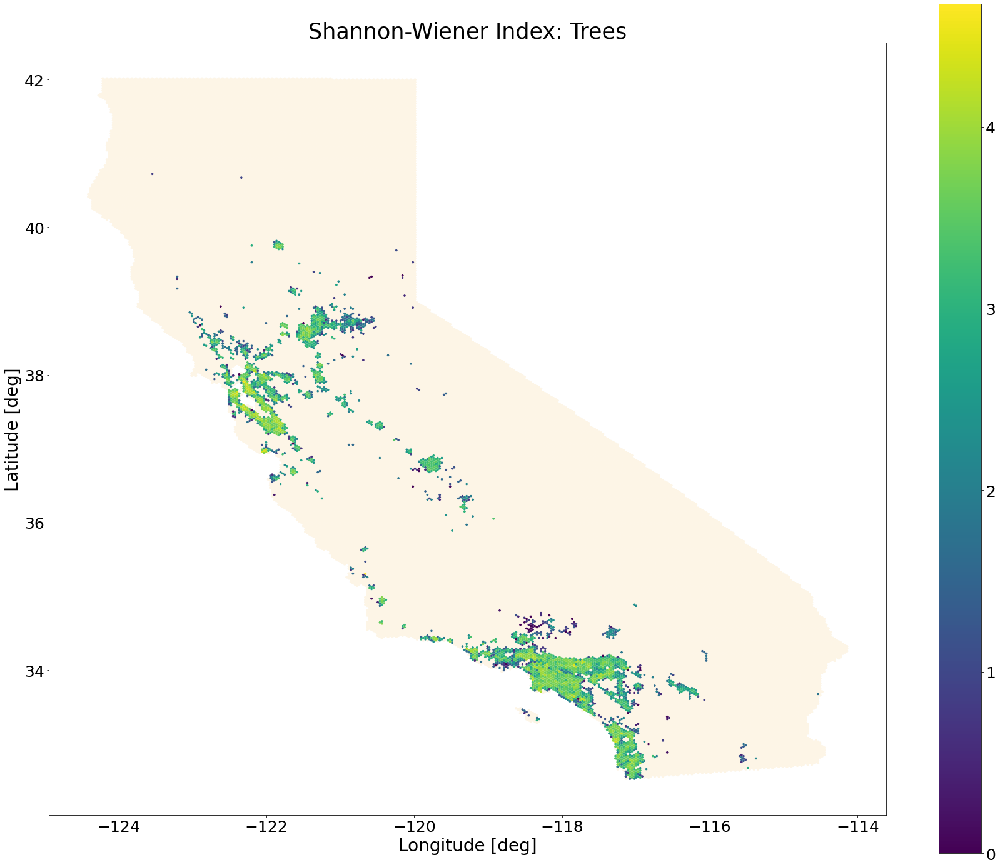

In [ ]:
fig,ax = plt.subplots(figsize=(30,25)) 
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_sw_trees.plot(column='H', missing_kwds={'color': 'oldlace'}, legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('Shannon-Wiener Index: Trees', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 

plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

fig.show() 

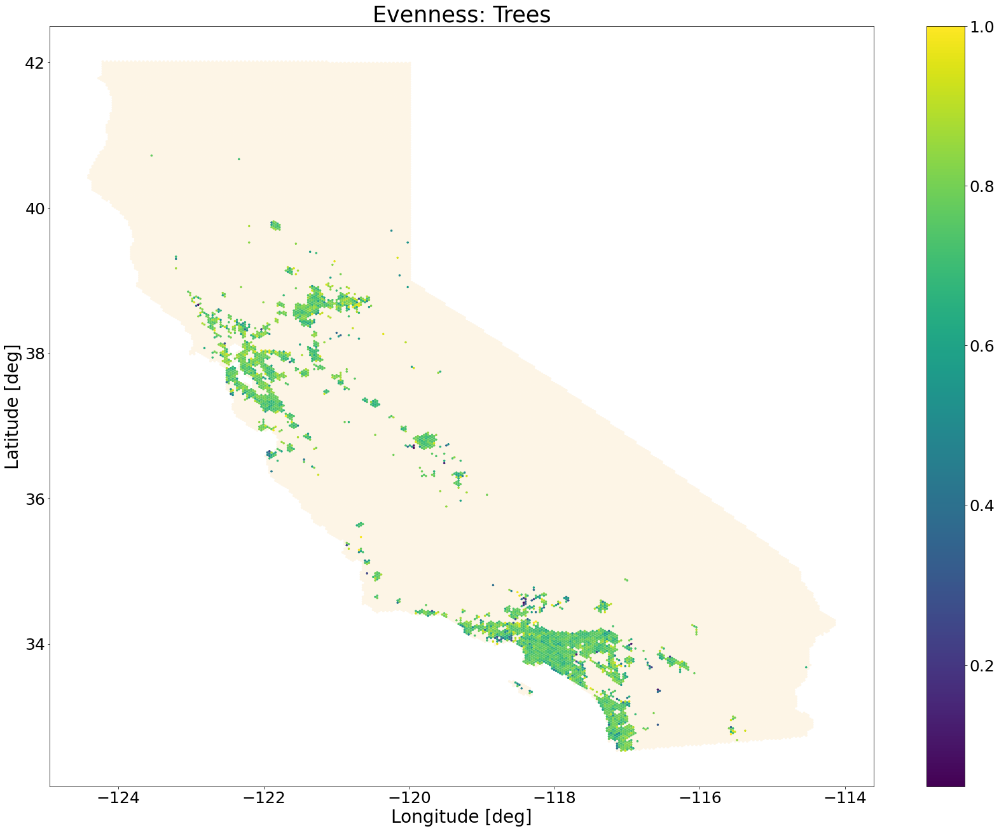

In [ ]:
fig,ax = plt.subplots(figsize=(30,22)) 
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_sw_trees.plot(column='E', missing_kwds={'color': 'oldlace'}, legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('Evenness: Trees', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 

plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

plt.savefig('Evenness_trees.png')
fig.show() 

##### Birds

In [ ]:
%%bigquery --project urban-forest-269703 df_birds
SELECT 
  grid, verbatimScientificName as species, sum(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid, verbatimScientificName

In [ ]:
%%bigquery --project urban-forest-269703 df_birds2
SELECT 
  grid, sum(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid
HAVING sum(individualCount) >= 50

In [ ]:
df_birds['grid'] = df_birds['grid'].astype('category')
df_birds2['grid'] = df_birds2['grid'].astype('category')

species_counts_birds = df_birds.merge(df_birds2, how='inner', on='grid')

In [ ]:
species_counts_birds['p_i'] = species_counts_birds['count_x'] / species_counts_birds['count_y'] 
pi_birds = species_counts_birds[['grid', 'species', 'p_i']].copy()

pi_birds['ln p_i'] = np.log(pi_birds['p_i'])
pi_birds['H_i'] = pi_birds['p_i'] * pi_birds['ln p_i']

In [ ]:
df_sw_birds = pi_birds.groupby('grid').agg({'H_i': 'sum'})

df_sw_birds.columns = ['H']
df_sw_birds.reset_index(inplace=True)
df_sw_birds['H'] = abs(df_sw_birds['H'])

In [ ]:
df_species_counts_birds= df_birds.groupby('grid').agg(count=pd.NamedAgg(column='species', aggfunc='nunique'))
df_species_counts_birds.reset_index(inplace=True)

In [ ]:
df_sw_birds = df_sw_birds.merge(df_species_counts_birds, how='inner') 
df_sw_birds.columns = ['grid', 'H', 'S']
df_sw_birds['H_max'] = np.log(df_sw_birds['S'])
df_sw_birds['E'] = df_sw_birds['H'] / df_sw_birds['H_max']

In [ ]:
df_sw_birds = df_sw_birds.merge(df_grid, how='right', left_on='grid', right_on='ID') 

gdf_sw_birds = gpd.GeoDataFrame(df_sw_birds)

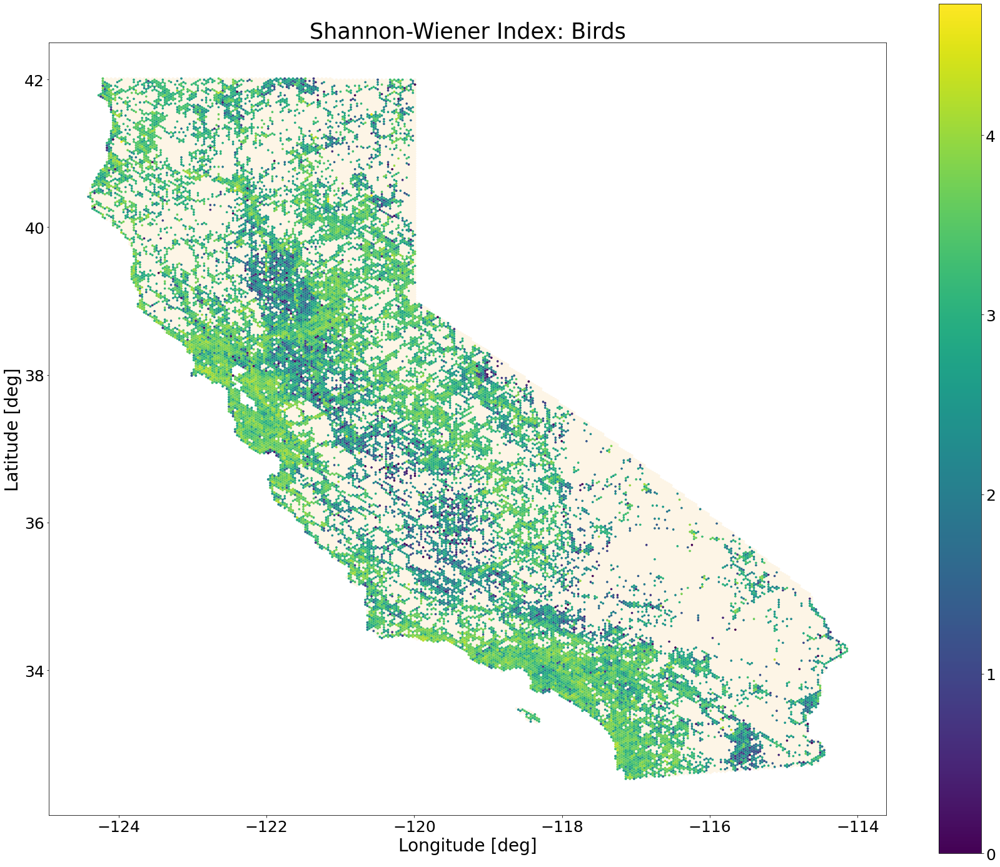

In [ ]:
fig,ax = plt.subplots(figsize=(30, 25)) 
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_sw_birds.plot(column='H', missing_kwds={'color': 'oldlace'}, legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('Shannon-Wiener Index: Birds', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

fig.show() 

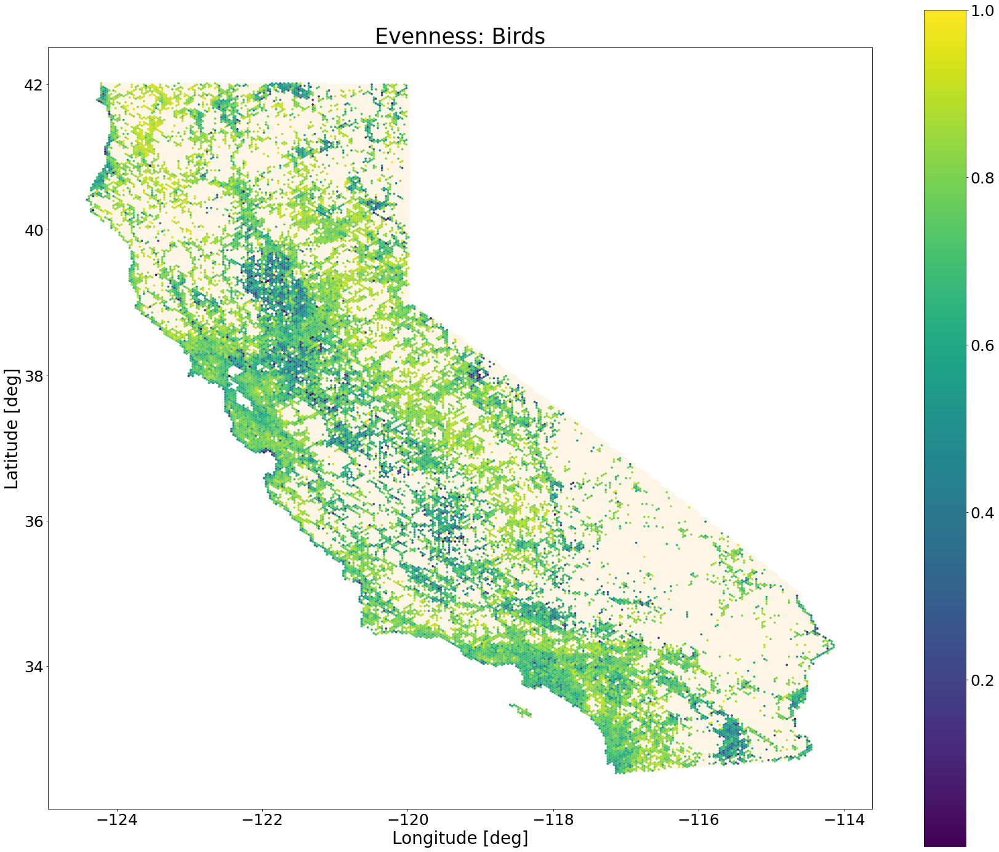

In [ ]:
fig,ax = plt.subplots(figsize=(30,25)) 
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_sw_birds.plot(column='E', missing_kwds={'color': 'oldlace'}, legend=True, ax=ax) 
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('Evenness: Birds', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

plt.savefig('Evenness_birds.png')
fig.show() 

##### Merged

In [ ]:
df_sw_merged = df_sw_birds.merge(df_sw_trees, on='ID', suffixes=('_birds', 
                                                                 '_trees'))

In [ ]:
df_sw_merged = df_sw_merged[df_sw_merged['H_birds'].notna()]
df_sw_merged = df_sw_merged[df_sw_merged['H_trees'].notna()]

In [ ]:
df_sw_merged['E_trees'].isna().value_counts()

False    2836
True       32
Name: E_trees, dtype: int64

In [ ]:
df_sw_merged['geometry'] = df_sw_merged['geometry_birds']
gdf_sw_merged  = gpd.GeoDataFrame(df_sw_merged, crs='EPSG:4326')

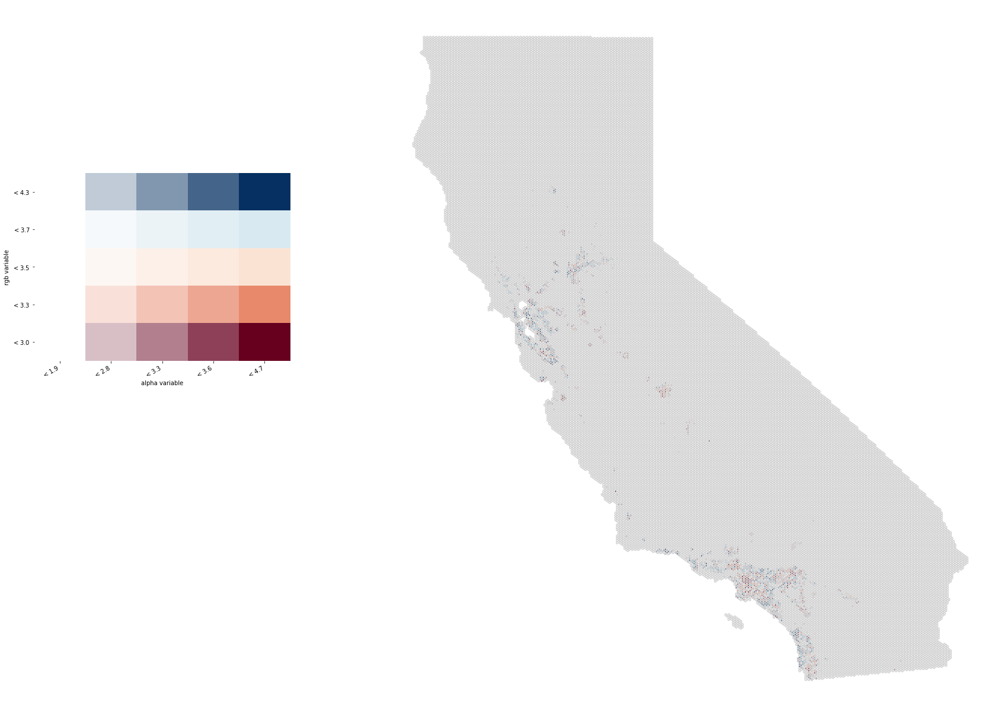

In [ ]:
from splot.mapping import vba_choropleth

fig,ax = plt.subplots(figsize=(30, 22)) 

x = gdf_sw_merged['H_birds']
y = gdf_sw_merged['H_trees']

vba_choropleth(x, y, gdf_sw_merged, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid.boundary.plot(ax=ax, color='lightgrey') 

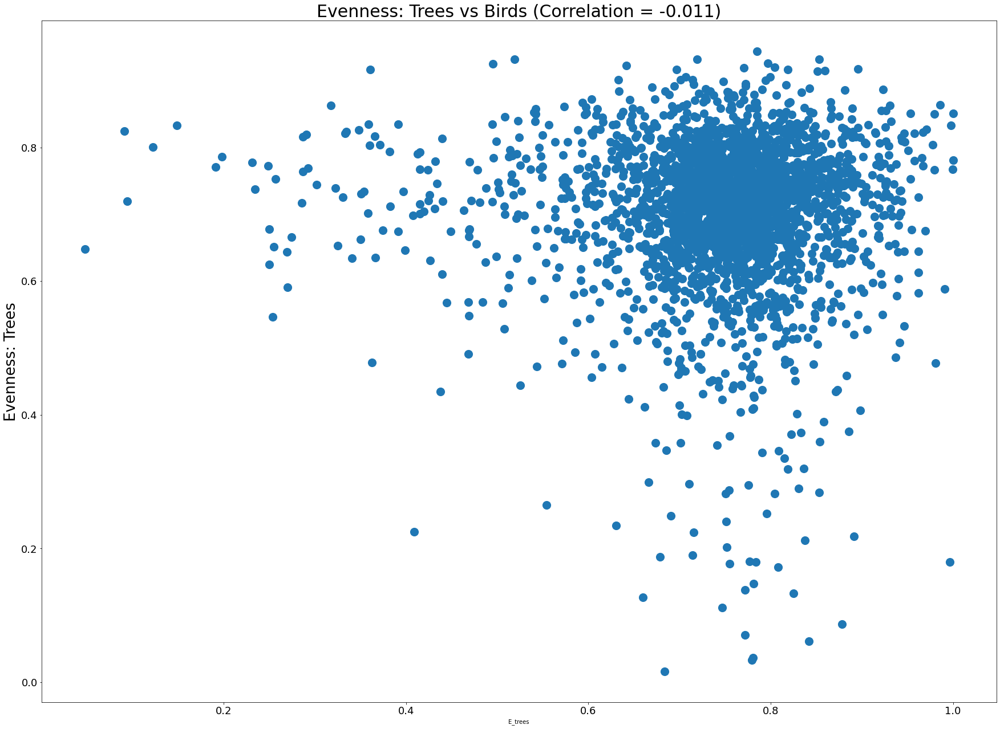

In [ ]:
correlation = df_sw_merged['E_trees'].corr(df_sw_merged['E_birds'])
corr_str = str(round(correlation, 3))

fig,ax = plt.subplots(figsize=(30,22)) 
df_sw_merged.plot(kind='scatter', x='E_trees', y='E_birds', s=200, ax=ax)

ax.set_ylabel('Evenness: Birds', fontdict={'fontsize': 26,
                                           'fontweight': 'medium'})
ax.set_ylabel('Evenness: Trees', fontdict={'fontsize': 26,
                                           'fontweight': 'medium'})
ax.set_title('Evenness: Trees vs Birds (Correlation = ' + corr_str + ')', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

plt.xticks(fontsize=18)
plt.yticks(fontsize=18)

fig.show() 

##### Add to aggregation table

In [ ]:
df_even = df_sw_merged[['E_birds', 'E_trees', 'FID']]
df_even = df_even.rename({'E_birds': 'EvenBirds', 
                              'E_trees': 'EvenTrees',
                              'FID': 'ID'}, axis=1) 

In [ ]:
df_even

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.evenness_127km'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
df_even.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:06,  6.11s/it]


## Love Index


In [ ]:
def love_index(df):
  df.reset_index(inplace=True)
  df = df.sort_values('count_species', ascending=False)
  midpoint = df['count_total'][0] / 2 
  love_index = np.sum(df['count_species'].cumsum() <= midpoint)
  return love_index

##### Bird data

In [ ]:
%%bigquery --project urban-forest-269703 df_birds
SELECT 
  grid, verbatimScientificName as species, SUM(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid, verbatimScientificName

In [ ]:
%%bigquery --project urban-forest-269703 df_birds2
SELECT 
  grid, SUM(individualCount) as count
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid
having sum(individualCount) >= 50

In [ ]:
df_birds_merged = df_birds.merge(df_birds2, on='grid', suffixes=('_species', 
                                                                 '_total'))

df_love_index = df_birds_merged.groupby('grid').agg(love_index).reset_index()
df_love_index = df_love_index[['grid', 'species']]
df_love_index = df_love_index.merge(df_grid, how='right', left_on='grid', right_on='ID')

df_love_index.rename(columns={'species': 'LoveIndex_Birds'}, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/groupby/generic.py:303: FutureWarning: Dropping invalid columns in SeriesGroupBy.agg is deprecated. In a future version, a TypeError will be raised. Before calling .agg, select only columns which should be valid for the aggregating function.
  results[key] = self.aggregate(func)


##### Tree data

In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT 
  grid, species, count(species) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
GROUP BY grid, species 

In [ ]:
%%bigquery --project urban-forest-269703 df_trees2
SELECT 
  grid, count(species) as count
FROM `urban-forest-269703.urbanforest.final-with-grid`
GROUP BY grid
having count(grid) >= 10 

In [ ]:
df_trees_merged = df_trees.merge(df_trees2, on='grid', suffixes=('_species', 
                                                                 '_total'))

df_love_index2 = df_trees_merged.groupby('grid').agg(love_index).reset_index()
df_love_index2 = df_love_index2[['grid', 'species']]
df_love_index2 = df_love_index2.merge(df_grid, how='right', left_on='grid', right_on='ID')

df_love_index2.rename(columns={'species': 'LoveIndex_Trees'}, inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/groupby/generic.py:303: FutureWarning: Dropping invalid columns in SeriesGroupBy.agg is deprecated. In a future version, a TypeError will be raised. Before calling .agg, select only columns which should be valid for the aggregating function.
  results[key] = self.aggregate(func)


##### Plot

In [ ]:
df_love_index_merged = df_love_index.merge(df_love_index2, on ='ID')

df_love_index_merged = df_love_index_merged[['LoveIndex_Birds', 'ID', 
                                            'geometry_x', 'LoveIndex_Trees']].copy()
df_love_index_merged.rename(columns={'geometry_x': 'geometry'}, inplace=True)

gdf_love_index = gpd.GeoDataFrame(df_love_index_merged)

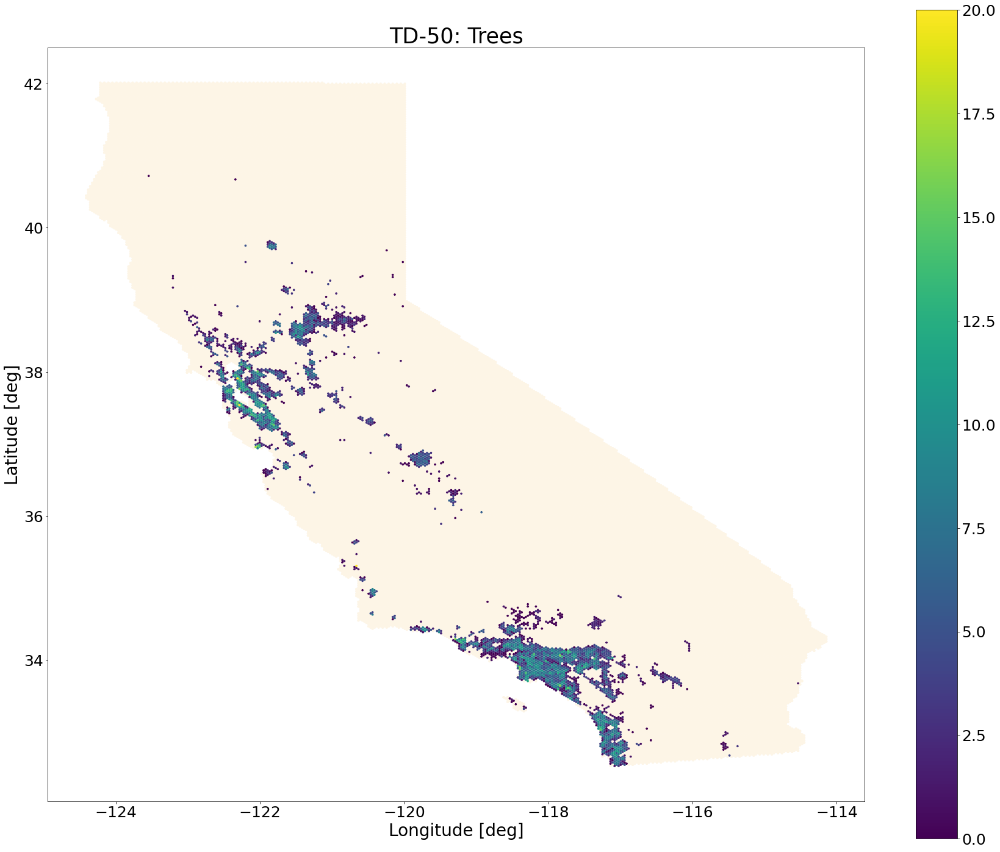

In [ ]:
fig,ax = plt.subplots(figsize=(30,25))
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_love_index.plot(column='LoveIndex_Trees', missing_kwds={'color': 'oldlace'}, legend=True,ax=ax) 

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('TD-50: Trees', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'})

plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)
 
plt.savefig('td50_trees.png')
fig.show() 

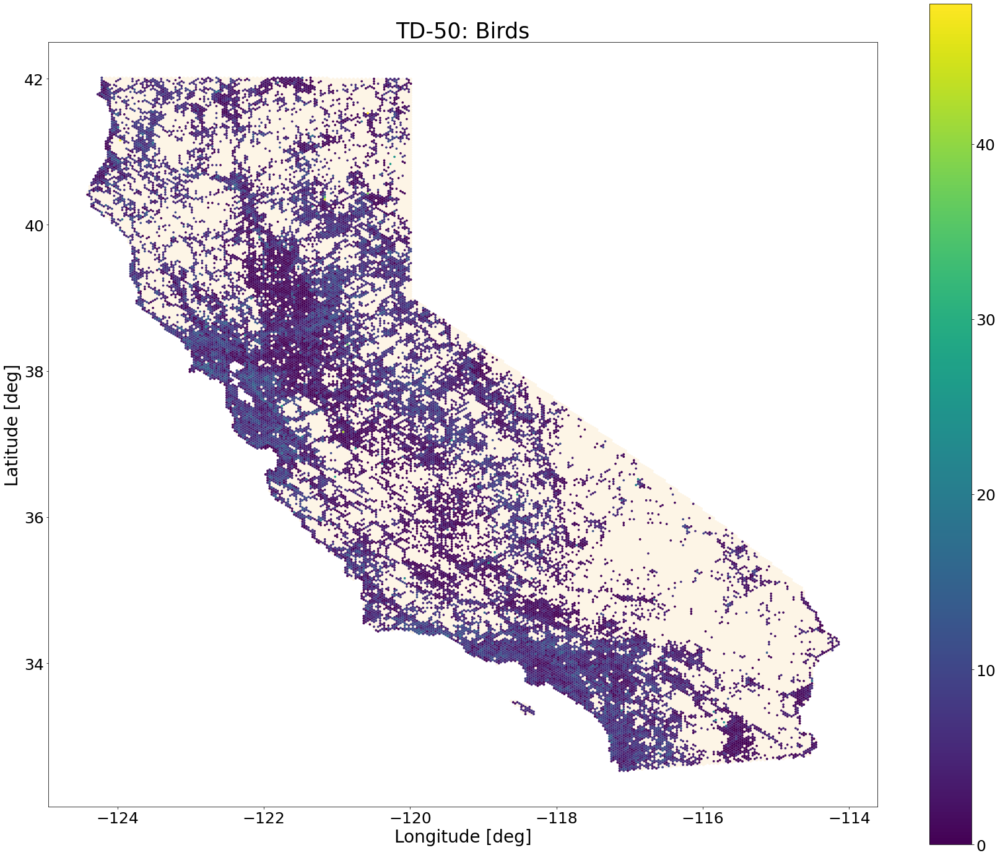

In [ ]:
fig,ax = plt.subplots(figsize=(30,25)) 
df_grid.plot(ax=ax, color='oldlace')
ax2 = gdf_love_index.plot(column='LoveIndex_Birds', missing_kwds={'color': 'oldlace'}, legend=True,ax=ax) 

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('TD-50: Birds', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

plt.savefig('td50_birds.png')
fig.show() 

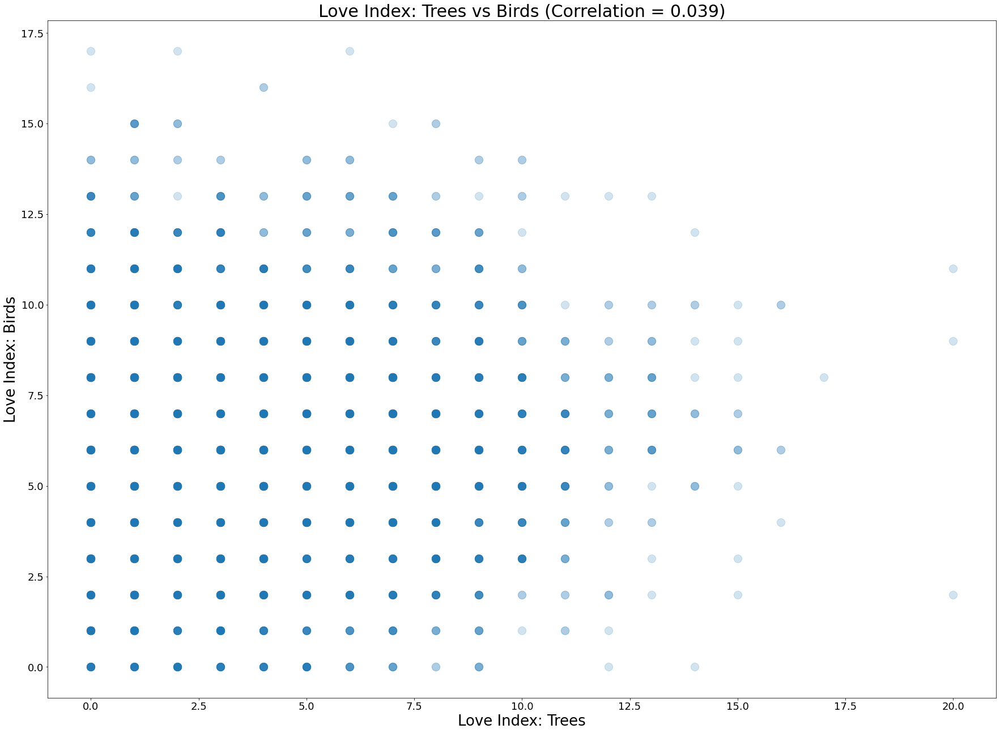

In [ ]:
correlation = df_love_index_merged['LoveIndex_Trees'].corr(df_love_index_merged['LoveIndex_Birds'])
corr_str = str(round(correlation, 3))

fig,ax = plt.subplots(figsize=(30,22)) 
df_love_index_merged.plot(kind='scatter', x='LoveIndex_Trees', y='LoveIndex_Birds', 
                          s=200, alpha=0.2, ax=ax)

ax.set_ylabel('Love Index: Birds', fontdict={'fontsize': 26,
                                           'fontweight': 'medium'})
ax.set_xlabel('Love Index: Trees', fontdict={'fontsize': 26,
                                           'fontweight': 'medium'})
ax.set_title('Love Index: Trees vs Birds (Correlation = ' + corr_str + ')', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

plt.xticks(fontsize=18)
plt.yticks(fontsize=18)

fig.show() 

##### Add to aggregation table

In [ ]:
df_love = df_love_index_merged[['LoveIndex_Birds', 'LoveIndex_Trees', 'FID']]
df_love = df_love.rename({'LoveIndex_Birds': 'LoveBirds', 
                          'LoveIndex_Trees': 'LoveTrees',
                          'FID': 'ID'}, axis=1)

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.love_127km'
#BQproject name variable
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
df_love.to_gbq(BqDatasetwithtable, BqProject, chunksize=10000, if_exists='append')

1it [00:06,  6.31s/it]


## Count of Birds and Trees (Hexagon)

In [ ]:
%%bigquery --project urban-forest-269703 df_trees
SELECT 
  grid, COUNT(species) as count_trees
FROM `urban-forest-269703.urbanforest.final`
GROUP BY grid

In [ ]:
%%bigquery --project urban-forest-269703 df_birds2
SELECT 
  grid, SUM(individualCount) as count_birds
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid

In [ ]:
df_merged = df_trees.merge(df_grid, how='right', left_on='grid', right_on='FID') 
df_merged = df_birds2.merge(df_merged, how='right', left_on='grid', right_on='FID') 
gdf_merged = gpd.GeoDataFrame(df_merged, crs='EPSG:4326')

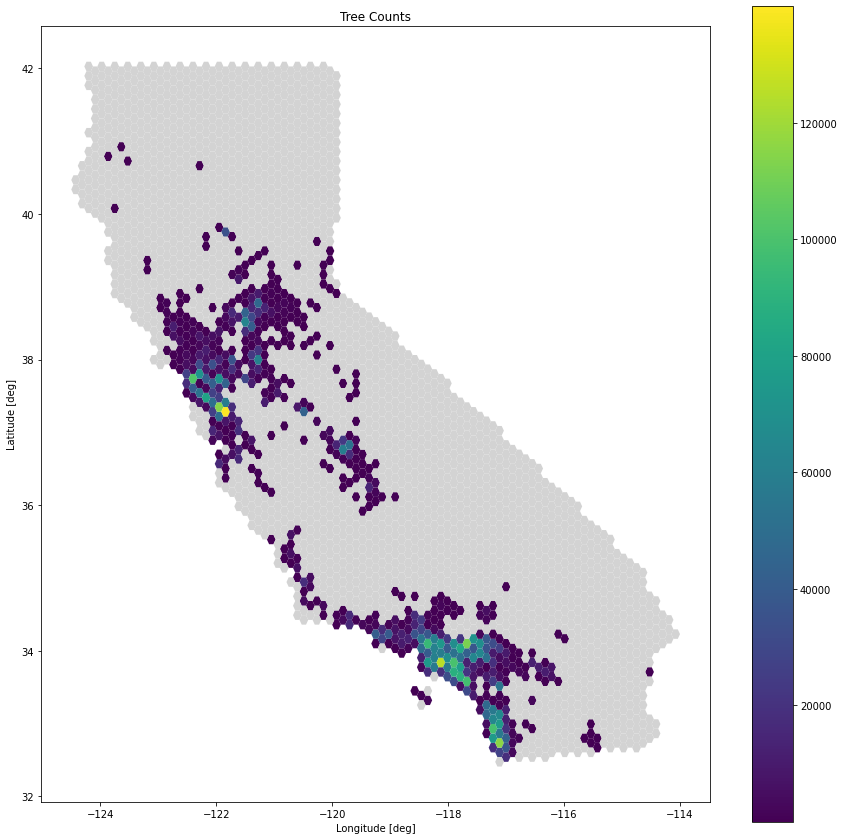

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
gdf_merged.plot(column='count_trees', missing_kwds={'color': 'lightgrey'}, legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Tree Counts') 
fig.show() 

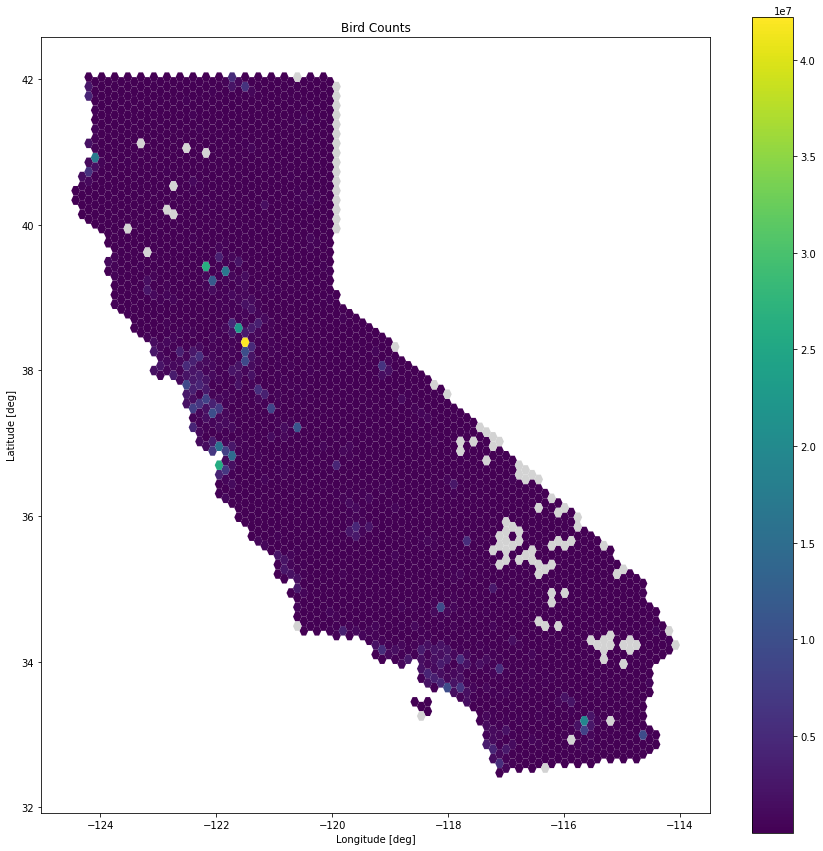

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
gdf_merged.plot(column='count_birds', missing_kwds={'color': 'lightgrey'}, legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Bird Counts') 
fig.show() 

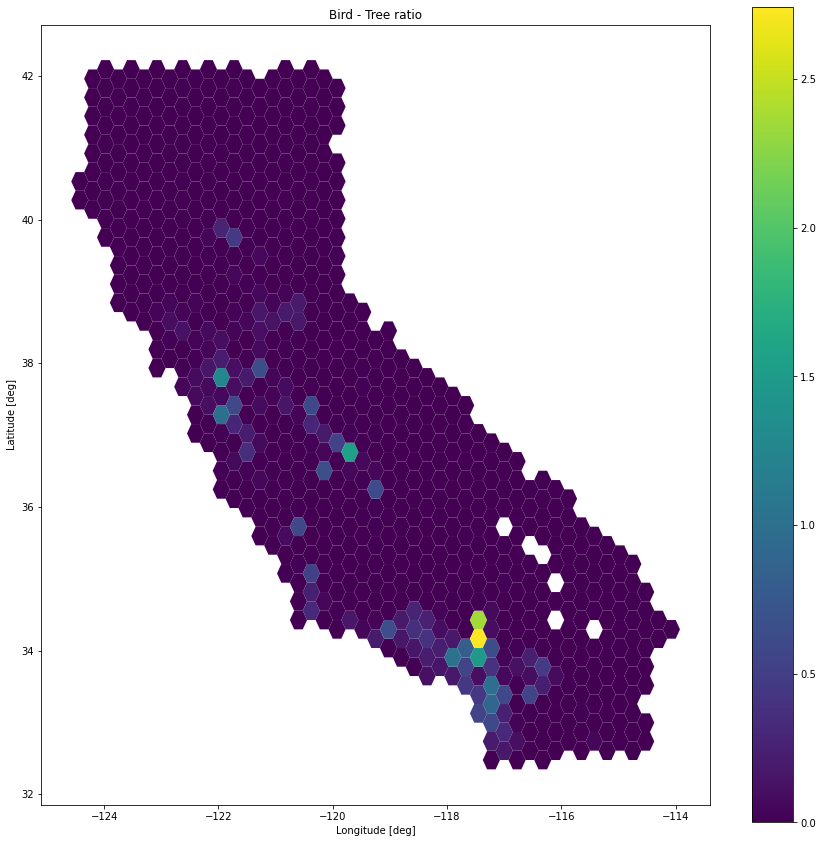

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
df_merged.plot(column='ratio',legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Bird - Tree ratio') 
fig.show() 

## Zip code counts for trees

In [ ]:
%%bigquery --project urban-forest-269703 df_trees_zip 
SELECT 
  zip 
FROM `urban-forest-269703.urbanforest.final` 
ORDER BY RAND() 
LIMIT 1000000 

In [ ]:
df_trees_zip['count'] = 1 
df_trees_counts = df_trees_zip.groupby('zip').count().reset_index()

In [ ]:
df_merged = df_trees_counts.merge(zipcode_gdf, how='right', left_on='zip', right_on='ZCTA5CE10')

In [ ]:
merged_gdf = gpd.GeoDataFrame(df_merged,geometry='geometry',crs='EPSG:4326')

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
merged_gdf.plot(column='count',legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Tree Counts by Zipcode') 
fig.show() 

In [ ]:
df_merged.sort_values('count', ascending=False)

In [ ]:
# Alternative (much slower) 
# df_joined = gdf_trees.sjoin(zipcode_gdf, how='right', predicate='within') 
# df_joined['count'] = 1
# df_joined_sub = df_joined[['zip', 'geometry', 'count']]
# dissolved = df_joined_sub.dissolve(by='zip', aggfunc='sum')

In [ ]:
# county_gdf = gpd.read_file('https://opendata.arcgis.com/datasets/8713ced9b78a4abb97dc130a691a8695_0.geojson')
# df_joined = gdf_trees.sjoin(county_gdf, how='right', predicate='within') 

## Zip code count for birds

In [ ]:
df_joined2_sub = df_joined2[['individualCount', 'ZCTA5CE10', 'geometry']]
dissolved = df_joined2_sub.dissolve(by='ZCTA5CE10', aggfunc='sum')

In [ ]:
dissolved.sort_values('individualCount', ascending=False)

,geometry,individualCount
ZCTA5CE10,,
95758,"POLYGON ((-121.44538 38.43957, -121.44526 38.4...",81620.0
95521,"POLYGON ((-124.23991 40.77340, -124.23804 40.7...",34428.0
92037,"POLYGON ((-117.28471 32.84041, -117.28374 32.8...",33144.0
95912,"MULTIPOLYGON (((-122.07323 39.11557, -122.0686...",28567.0
94060,"POLYGON ((-122.34820 37.30393, -122.34709 37.3...",25891.0
...,...,...
95324,"POLYGON ((-120.80502 37.39919, -120.80504 37.3...",0.0
92655,"MULTIPOLYGON (((-117.98954 33.73896, -117.9895...",0.0
92377,"POLYGON ((-117.39030 34.13586, -117.39148 34.1...",0.0


In [ ]:
df_joined2[df_joined2['ZCTA5CE10'] == '95758'].sort_values('individualCount', ascending=False)

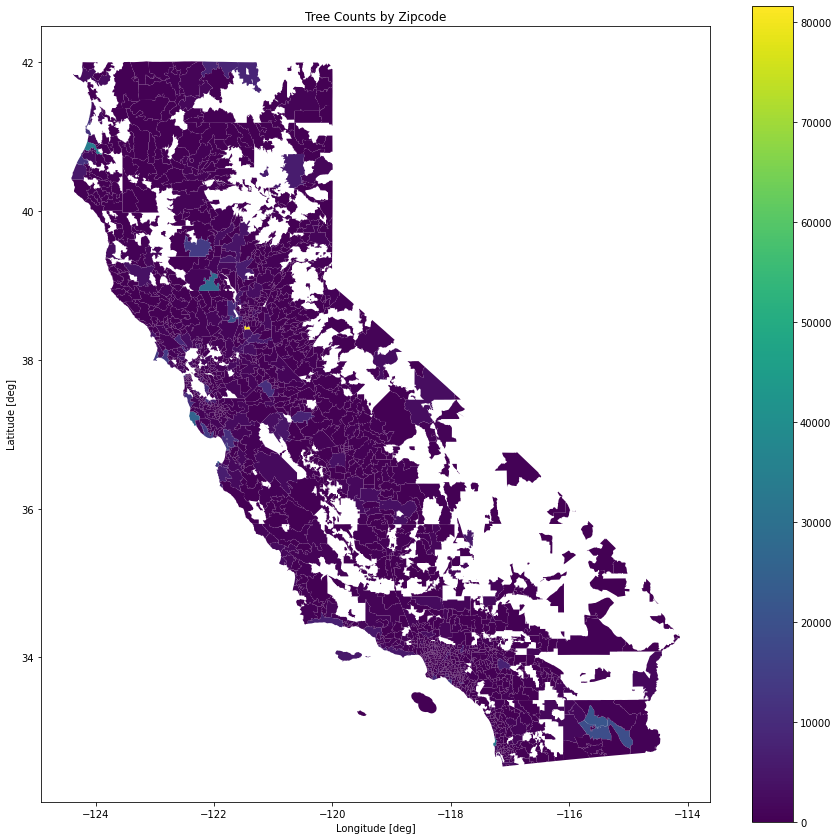

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
dissolved.plot(column='individualCount',legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Tree Counts by Zipcode') 
fig.show() 

## Diversity


In [ ]:
%%bigquery --project urban-forest-269703 df_trees2
SELECT 
  latitude, longitude, nativity 
FROM `urban-forest-269703.urbanforest.final`
ORDER BY RAND()
LIMIT 1000000 

In [ ]:
%%bigquery --project urban-forest-269703 df_birds2
SELECT 
  decimalLatitude, decimalLongitude, individualCount, verbatimScientificName
FROM `urban-forest-269703.ebird.ebird-final`
ORDER BY RAND()
LIMIT 1000000 

In [ ]:
gdf_trees2 = gpd.GeoDataFrame(df_trees2,geometry=gpd.GeoSeries.from_xy(df_trees2.longitude,df_trees2.latitude),crs='EPSG:4326')
gdf_birds2 = gpd.GeoDataFrame(df_birds2,geometry=gpd.GeoSeries.from_xy(df_birds2.decimalLongitude,df_birds2.decimalLatitude),crs='EPSG:4326')

In [ ]:
df_bird_count2 = gdf_birds2.sjoin(df_grid, how='right', predicate='within')
df_bird_count2 = df_bird_count2.groupby('FID').agg(count=pd.NamedAgg(column='verbatimScientificName', aggfunc='nunique'))
df_bird_count2.reset_index(inplace=True)

In [ ]:
df_bird_count_grid2 = pd.merge(left=df_bird_count2, right=df_grid)
df_bird_count_grid2.rename(columns={'count': 'CountUniqueBirds'}, inplace=True)
df_bird_count_grid2 = gpd.GeoDataFrame(df_bird_count_grid2, crs='EPSG:4326')

In [ ]:
df_tree_count2 = gdf_trees2.sjoin(df_grid, how='right', predicate='within')
df_tree_count2 = df_tree_count2.groupby('FID').agg(
    count=pd.NamedAgg(column='nativity', aggfunc='count'),
    sum=pd.NamedAgg(column='nativity', aggfunc='sum'))
df_tree_count2.reset_index(inplace=True)
df_tree_count2['prop'] = df_tree_count2['sum'] / df_tree_count2['count']

In [ ]:
df_tree_count2 = df_tree_count2[['FID', 'prop']]
df_tree_count_grid2 = pd.merge(left=df_tree_count2, right=df_grid)
df_tree_count_grid2.rename(columns={'prop': 'PropNative'}, inplace=True)
df_tree_count_grid2 = gpd.GeoDataFrame(df_tree_count_grid2, crs='EPSG:4326')

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
df_tree_count_grid2.plot(column='PropNative',legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Proportion of Native Trees') 
fig.show() 

In [ ]:
fig,ax = plt.subplots(figsize=(15,15)) 
df_bird_count_grid2.plot(column='CountUniqueBirds',legend=True,ax=ax) 
ax.set_xlabel('Longitude [deg]') 
ax.set_ylabel('Latitude [deg]') 
ax.set_title('Count of Unique Birds') 
fig.show() 

## Choropleth Plots

In [ ]:
%%bigquery --project urban-forest-269703 df_10km
SELECT *
FROM `urban-forest-269703.treebirdagg.10-km-agg-stats`

In [ ]:
%%bigquery --project urban-forest-269703 df_127km
SELECT *
FROM `urban-forest-269703.treebirdagg.127-km-agg-stats`

In [ ]:
gdf_10km = gpd.GeoDataFrame(df_10km, geometry=gpd.GeoSeries.from_wkt(df_10km.geometry), crs='EPSG:4326')
gdf_127km = gpd.GeoDataFrame(df_127km, geometry=gpd.GeoSeries.from_wkt(df_127km.geometry), crs='EPSG:4326')

In [ ]:
gdf_10km.head()

,ID,geometry,BirdCounts,TreeCounts,LogBirdCounts,LogTreeCounts,TreeSpeciesCounts,BirdSpeciesCounts,CountNativeTrees,PercentNativeTrees,CountNativeTreeSpecies,PercentNativeTreeSpecies,ShannonTree,ShannonBird,EvenTrees,EvenBirds,LoveTrees,LoveBirds
0,7445.0,"POLYGON ((-122.23853 37.87696, -122.24786 37.8...",86317.0,3974.0,11.365793,8.287780,211.0,195.0,683,0.171867,30,0.142180,3.514103,4.300901,0.803628,0.666433,15.0,7.0
1,18037.0,"POLYGON ((-120.64387 35.30876, -120.65320 35.3...",250523.0,6686.0,12.431310,8.807921,423.0,210.0,1330,0.198923,39,0.092199,2.605767,4.677136,0.773416,0.487323,20.0,2.0
2,8202.0,"POLYGON ((-122.09865 37.40855, -122.10797 37.4...",26041.0,8782.0,10.167466,9.080573,238.0,160.0,1625,0.185038,29,0.121849,3.463294,4.284038,0.782863,0.682399,14.0,7.0
3,7149.0,"POLYGON ((-122.29448 37.90927, -122.30381 37.9...",667087.0,5952.0,13.410677,8.691651,250.0,289.0,832,0.139785,30,0.120000,3.945558,4.561233,0.826092,0.696304,20.0,11.0
4,33818.0,"POLYGON ((-117.81825 34.06504, -117.82757 34.0...",3623.0,4432.0,8.195334,8.396832,271.0,91.0,557,0.125677,31,0.114391,3.478153,4.488169,0.801156,0.771062,16.0,6.0


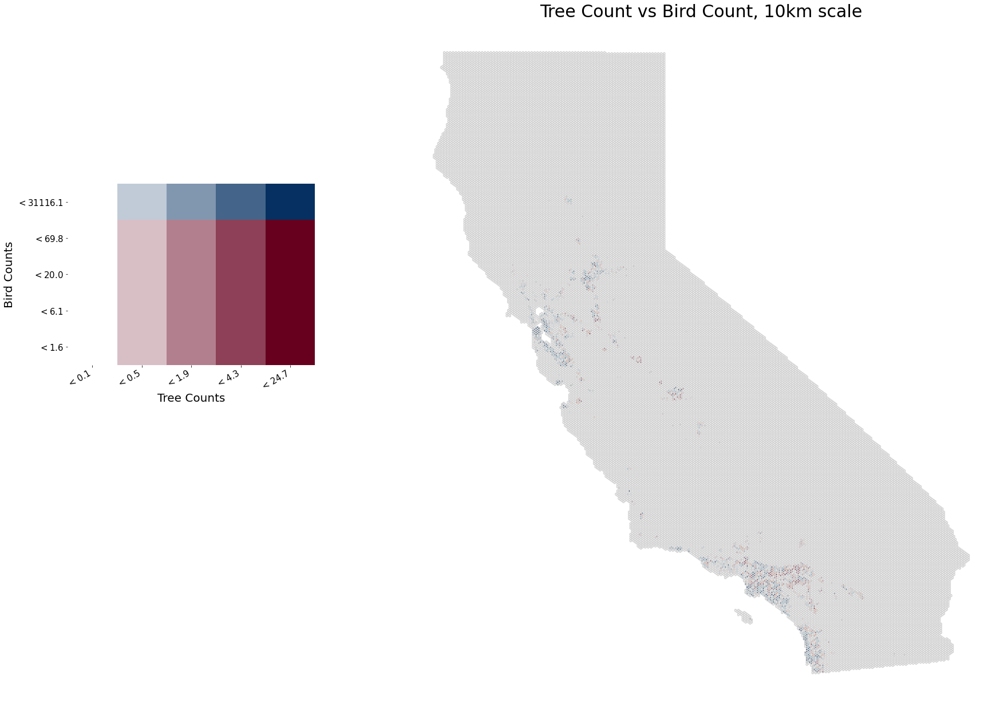

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_10km['BirdCounts']
y = gdf_10km['TreeCounts']

vba_choropleth(x, y, gdf_10km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Tree Count vs Bird Count, 10km scale', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

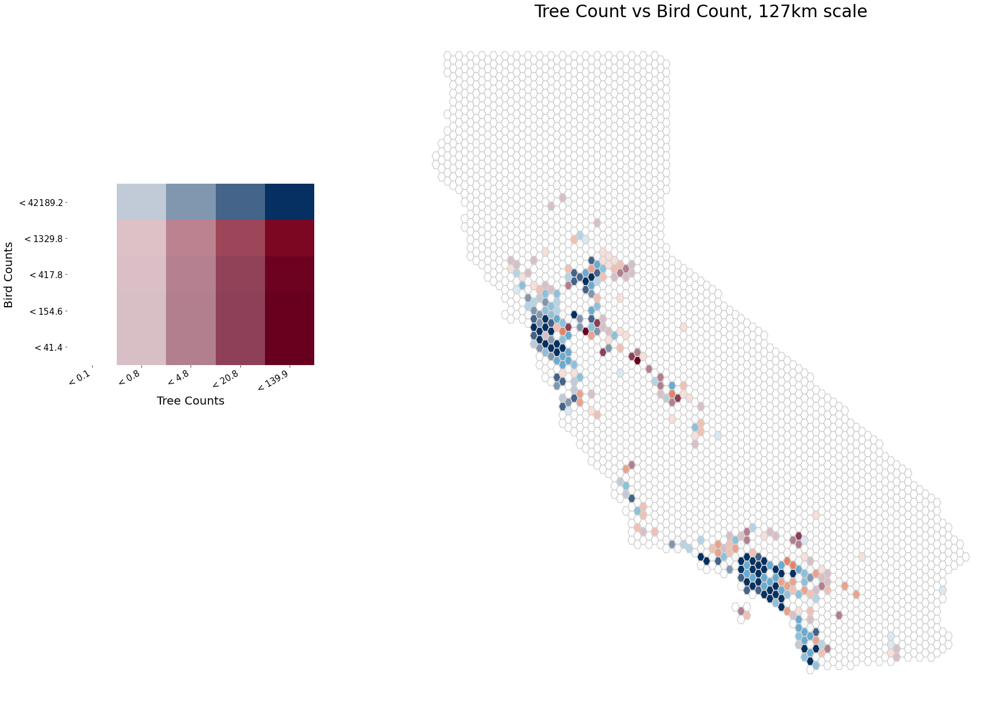

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_127km['BirdCount']
y = gdf_127km['TreeCount']

vba_choropleth(x, y, gdf_127km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid2.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Tree Count vs Bird Count, 127km scale', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

In [ ]:
gdf_127km.head()

,ID,geometry,CountTreeSpecies,CountNativeTreeSpecies,PercentNativeTreeSpecies,CountBirdSpecies,CountNativeTrees,PercentNativeTree,BirdCount,TreeCount,ShannonTree,ShannonBird,EvenBirds,EvenTrees,LoveBirds,LoveTrees
0,2452,"POLYGON ((-116.81250 32.99557, -116.85000 32.9...",26,1,0.038462,261,37,0.047436,239777,780.0,4.049432,1.334569,0.727724,0.409616,11.0,0.0
1,2192,"POLYGON ((-117.71250 34.42451, -117.75000 34.3...",2,1,0.500000,209,1,0.083333,66265,12.0,4.249390,0.286836,0.795418,0.413817,16.0,0.0
2,1700,"POLYGON ((-119.40000 36.43802, -119.43750 36.3...",2,1,0.500000,69,22,0.956522,1308,23.0,3.059047,0.178845,0.722478,0.258019,4.0,0.0
3,1960,"POLYGON ((-118.50000 34.61937, -118.53750 34.5...",2,1,0.500000,106,108,0.981818,3351,110.0,3.885189,0.090876,0.833117,0.131107,12.0,0.0
4,1235,"POLYGON ((-120.41250 34.81422, -120.45000 34.7...",2,1,0.500000,183,10,0.769231,58771,13.0,4.005471,0.540204,0.768880,0.779350,11.0,0.0


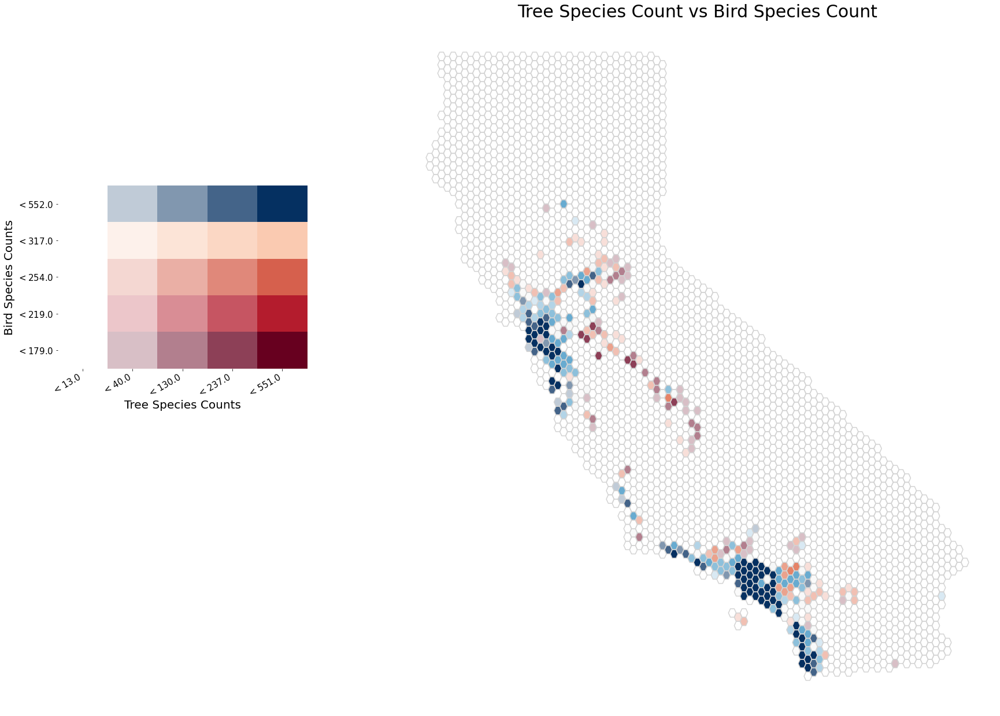

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_127km['CountBirdSpecies']
y = gdf_127km['CountTreeSpecies']

vba_choropleth(x, y, gdf_127km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid2.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Tree Species Count vs Bird Species Count', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Species Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Species Counts', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

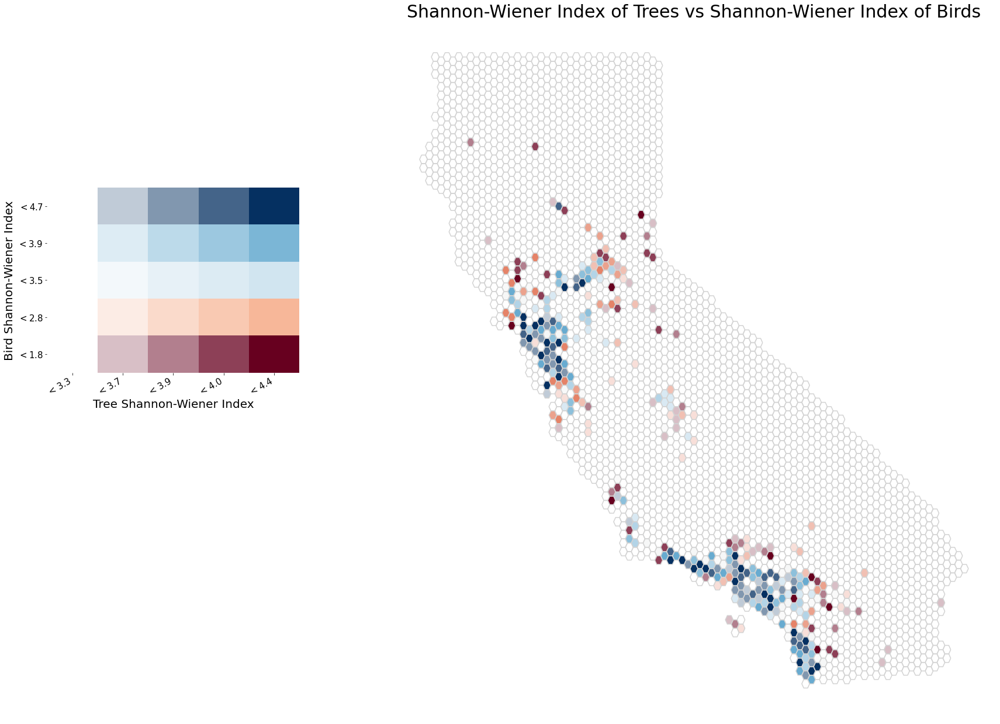

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_127km['ShannonBird']
y = gdf_127km['ShannonTree']

vba_choropleth(x, y, gdf_127km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid2.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Shannon-Wiener Index of Trees vs Shannon-Wiener Index of Birds', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Shannon-Wiener Index', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Shannon-Wiener Index', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

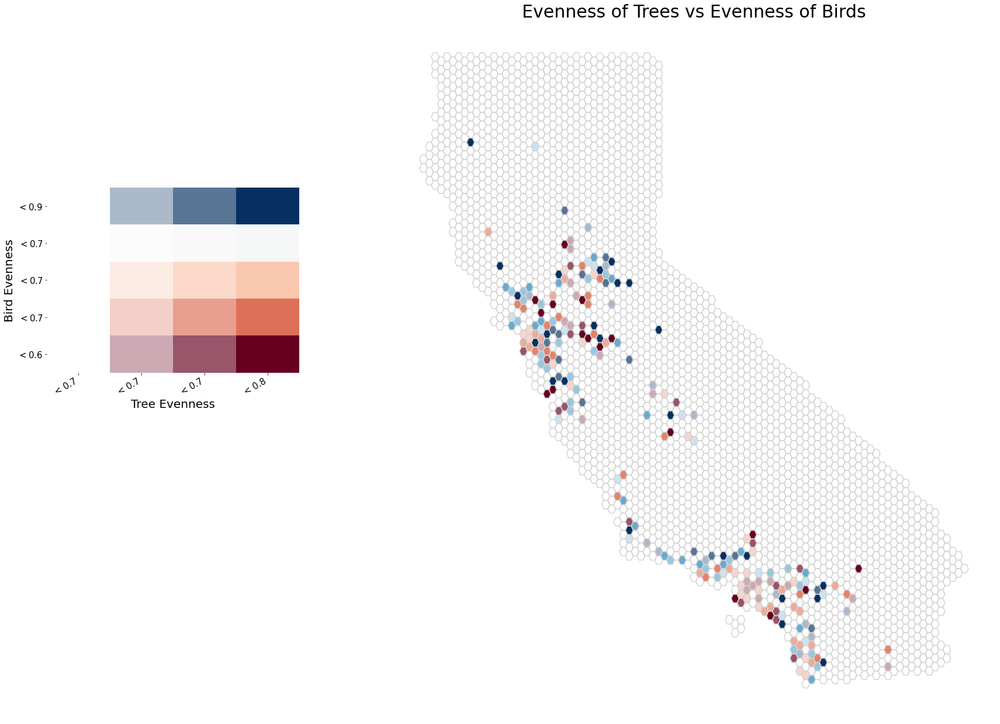

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_127km['EvenBirds']
y = gdf_127km['EvenTrees']

vba_choropleth(x, y, gdf_127km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid2.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Evenness of Trees vs Evenness of Birds', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Evenness', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Evenness', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

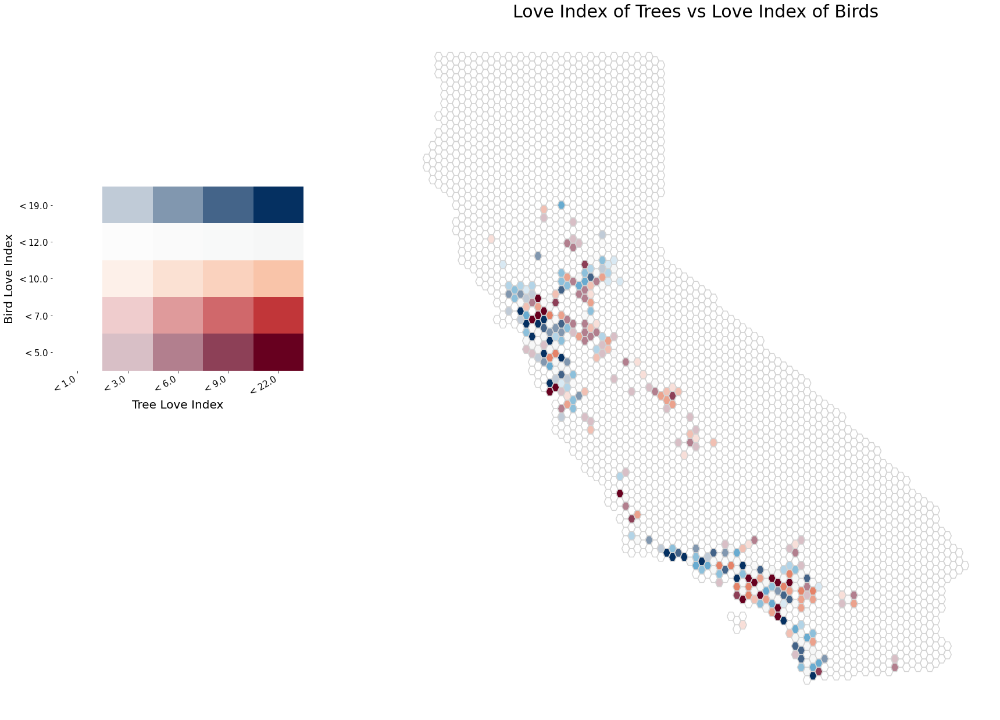

In [ ]:
fig = plt.figure(figsize=(30, 22)) 
ax = fig.add_subplot(111)

x = gdf_127km['LoveBirds']
y = gdf_127km['LoveTrees']

vba_choropleth(x, y, gdf_127km, rgb_mapclassify=dict(classifier='quantiles'),
               alpha_mapclassify=dict(classifier='quantiles'),
               cmap='RdBu',
               revert_alpha=False,
               ax=ax,
               legend=True)

df_grid2.boundary.plot(ax=ax, color='lightgrey') 

ax.set_title('Love Index of Trees vs Love Index of Birds', 
             fontdict={'fontsize': 30, 'fontweight': 'medium'})

legend_ax = fig.axes[1]
legend_ax.set_ylabel('Bird Love Index', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.set_xlabel('Tree Love Index', fontdict={'fontsize': 20,
                                           'fontweight': 'medium'})
legend_ax.tick_params(axis='both', which='major', labelsize=15)

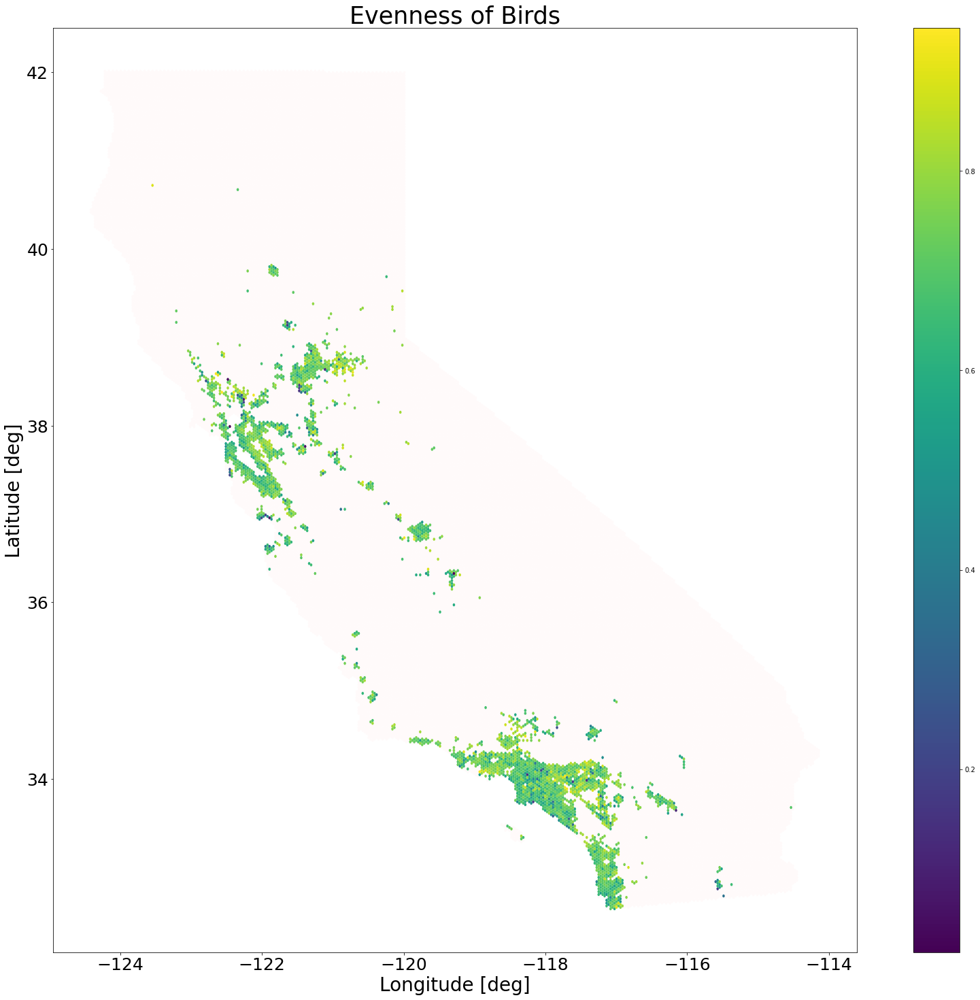

In [ ]:
fig,ax = plt.subplots(figsize=(30, 25))
df_grid.plot(ax=ax, color='snow')
gdf_10km.plot(ax=ax, column=gdf_10km['EvenBirds'], legend=True)
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28, 'fontweight': 'medium'})
ax.set_title('Evenness of Birds',
             fontdict={'fontsize': 35, 'fontweight': 'medium'})
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
fig.show()

## Turnover

##### Making Turnover

In [ ]:
%%bigquery --project urban-forest-269703 df_10km
SELECT *
FROM `urban-forest-269703.treebirdagg.final-10km-stats`

Executing query with job ID: 036abb90-c6e2-4d27-9ec2-96552ffc8c39
Query executing: 0.76s


ERROR:
 404 Not found: Table urban-forest-269703:treebirdagg.final-10km-stats was not found in location us-west2

(job ID: 036abb90-c6e2-4d27-9ec2-96552ffc8c39)

              -----Query Job SQL Follows-----               

    |    .    |    .    |    .    |    .    |    .    |
   1:SELECT *
   2:FROM `urban-forest-269703.treebirdagg.final-10km-stats`
    |    .    |    .    |    .    |    .    |    .    |


In [ ]:
df_turnover = pd.DataFrame()

In [ ]:
%%bigquery --project urban-forest-269703 df_turnover
SELECT grid, array_agg(DISTINCT verbatimScientificName) as species_list
FROM `urban-forest-269703.ebird.ebird-final`
GROUP BY grid
HAVING sum(individualCount) >= 80

Executing query with job ID: feee10a4-7f7c-4ab5-b0e8-0b1974e8e870
Query executing: 5.16s

KeyboardInterrupt: ignored

In [ ]:
# %%bigquery --project urban-forest-269703 df_turnover
# SELECT grid, array_agg(DISTINCT species) as species_list
# FROM `urban-forest-269703.urbanforest.final-with-grid`
# GROUP BY grid 
# HAVING count(grid) >= 20 

In [ ]:
def absolute_turnover(species1, species2): 

  S1 = len(species1)
  S2 = len(species2)

  c = len(set(species1) & set(species2))

  to = (S1 - c) + (S2 - c)

  return to 

In [ ]:
df_turnover['beta_southeast'] = None
df_turnover['beta_southwest'] = None
df_turnover['beta_south'] = None 
df_turnover['beta_northwest'] = None
df_turnover['beta_northeast'] = None
df_turnover['beta_north'] = None 

df_turnover = df_turnover[df_turnover['grid'].notna()].copy() 

In [ ]:
for index, row in df_turnover.iterrows():
    
  try:
    sw = df_grid[df_grid['ID'] == row['grid']]['southwest'].values[0]
    se = df_grid[df_grid['ID'] == row['grid']]['southeast'].values[0]
    s = df_grid[df_grid['ID'] == row['grid']]['south'].values[0]
    nw = df_grid[df_grid['ID'] == row['grid']]['northwest'].values[0]
    ne = df_grid[df_grid['ID'] == row['grid']]['northeast'].values[0]
    n = df_grid[df_grid['ID'] == row['grid']]['north'].values[0]
  except IndexError:
    print(row)
    break
  current = row['grid']

  if sw != None:
    try:
      beta_sw = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                  df_turnover[df_turnover['grid'] == sw]['species_list'].values[0])
    except IndexError: 
      beta_sw = None
  if se != None: 
    try:
      beta_se = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                  df_turnover[df_turnover['grid'] == se]['species_list'].values[0])
    except IndexError:
      beta_se = None
  if s != None:
    try:
      beta_s = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                df_turnover[df_turnover['grid'] == s]['species_list'].values[0])
    except IndexError:
      beta_s = None
  if nw != None:
    try:
      beta_nw = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                  df_turnover[df_turnover['grid'] == nw]['species_list'].values[0])
    except IndexError:
      beta_nw = None
  if ne != None:
    try:
      beta_ne = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                  df_turnover[df_turnover['grid'] == ne]['species_list'].values[0])
    except IndexError:
      beta_ne = None
  if n != None:
    try:
      beta_n = absolute_turnover(df_turnover[df_turnover['grid'] == current]['species_list'].values[0], 
                                df_turnover[df_turnover['grid'] == n]['species_list'].values[0])
    except IndexError:
      beta_n = None

  df_turnover.loc[index, 'beta_southwest'] = beta_sw
  df_turnover.loc[index, 'beta_southeast'] = beta_se
  df_turnover.loc[index, 'beta_south'] = beta_s
  df_turnover.loc[index, 'beta_northwest'] = beta_nw
  df_turnover.loc[index, 'beta_northeast'] = beta_ne
  df_turnover.loc[index, 'beta_north'] = beta_n

In [ ]:
df_turnover['beta_average'] = df_turnover[['beta_southeast', 'beta_southwest',
                                           'beta_south', 'beta_northwest',
                                           'beta_northeast', 'beta_north']].mean(axis=1) 

df_turnover = df_turnover.merge(df_grid[['ID', 'geometry']], how='left', left_on='grid', right_on='ID')
df_turnover = gpd.GeoDataFrame(df_turnover, geometry=df_turnover.geometry, crs='EPSG:4326') 

df_turnover.rename({'beta_southeast': 'southeast',
                    'beta_southwest': 'southwest',
                    'beta_south': 'south',
                    'beta_northeast': 'northeast',
                    'beta_northwest': 'northwest',
                    'beta_north': 'north',
                    'beta_average': 'avg'
                    }, axis=1, inplace=True)

df_turnover = df_turnover[['ID', 'north', 'northeast', 'northwest', 'south', 
                           'southeast', 'southwest', 'avg', 'geometry']]

In [ ]:
#Dataset with Table name variable
BqDatasetwithtable='treebirdagg.beta_turnover_bird'
#BQproject name variable 
BqProject='urban-forest-269703'
# pandas-gbq method to load data
# append data if data table exists in BQ project 
# set chunk size of records to be inserted
df_turnover.to_gbq(BqDatasetwithtable, BqProject, 
                   chunksize=10000, if_exists='replace')

3it [00:15,  5.30s/it]


##### Read saved file and plot

In [ ]:
%%bigquery --project urban-forest-269703 df_turnover
SELECT *
FROM `urban-forest-269703.treebirdagg.beta_turnover_bird`

In [ ]:
gdf_turnover = gpd.GeoDataFrame(df_turnover, geometry=gpd.GeoSeries.from_wkt(df_turnover.geometry)) 

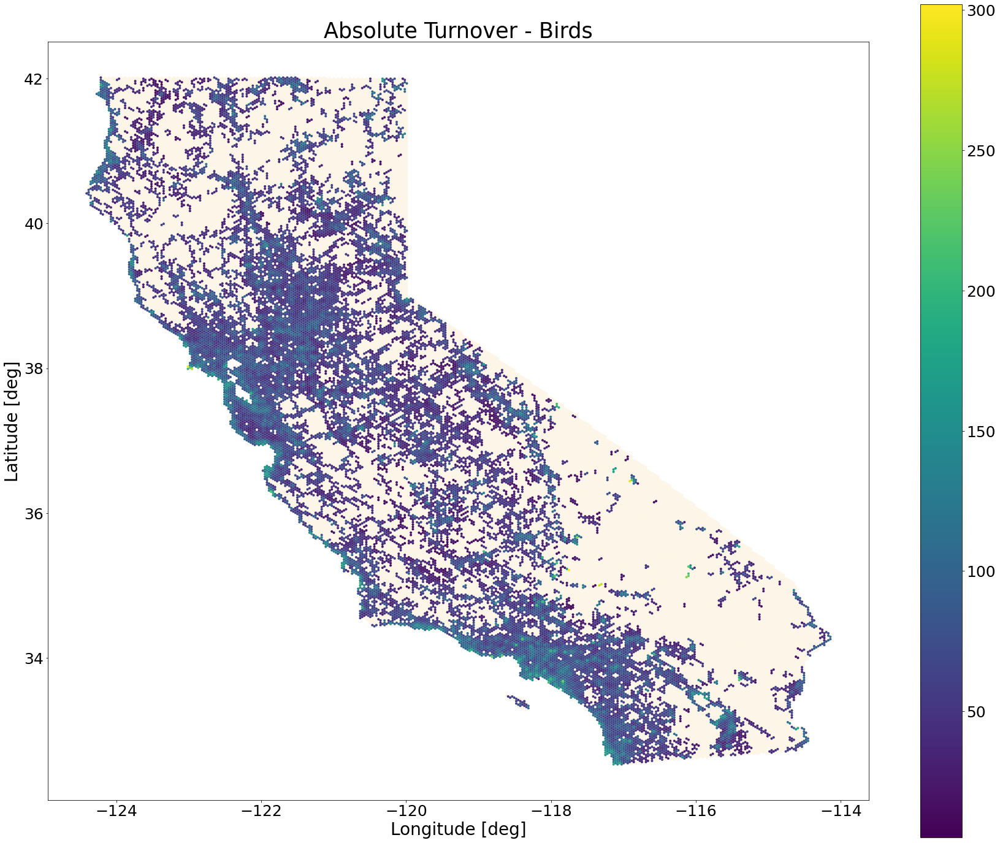

In [ ]:
fig,ax = plt.subplots(figsize=(30, 25)) 
df_grid.plot(ax=ax, color='oldlace') 
ax2 = gdf_turnover.plot(column='avg', missing_kwds={'color': 'oldlace'}, legend=True, ax=ax) 
ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                          'fontweight': 'medium'}) 
ax.set_title('Absolute Turnover - Birds', fontdict={'fontsize': 35, 
                                                    'fontweight': 'medium'}) 

plt.xticks(fontsize=25)
plt.yticks(fontsize=25) 
ax2.figure.axes[1].tick_params(labelsize=25)
fig.show() 

## Shannon-Wiener vs TD-50

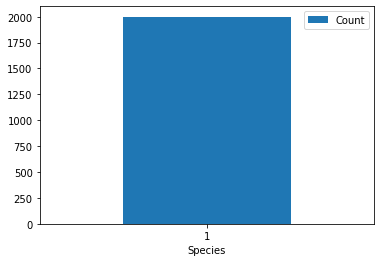

In [ ]:
df = pd.DataFrame({'Species':['1'], 
                   'Count':[2000]})
ax = df.plot.bar(x='Species', y='Count', rot=0) 

In [ ]:
np.log(2)

0.6931471805599453

In [ ]:
df['pi'] = df['Count'] / df['Count'].sum() 
df['ln_pi'] = np.log(df['pi'])
abs((df['pi'] * df['ln_pi']).sum())

0.06719688036269783

## Modeling

In [9]:
df_10km = pd.DataFrame()

In [10]:
%%bigquery --project urban-forest-269703 df_10km
select * except(BirdCounts, TreeCounts, LogBirdCounts, BirdSpeciesCounts, 
                PercentNativeTrees, EvenBirds, LoveTrees, LoveBirds, avg_beta_richness_tree,
                avg_beta_richness_bird, avg_beta_turnover_bird, avg_beta_turnover_tree)
FROM `urban-forest-269703.treebirdagg.10km-stats`

In [11]:
# clean and transform data before modeling

df_10km['PercentNativeTrees'] = df_10km['CountNativeTrees'] / np.exp(df_10km['LogTreeCounts'])
df_10km['PercentNativeTreeSpecies'] = df_10km['CountNativeTreeSpecies'] / df_10km['TreeSpeciesCounts']
df_10km['PercentNativeRegion'] = df_10km['nativeTree'] / np.exp(df_10km['LogTreeCounts'])
df_10km['PercentNativeRegionSpecies'] = df_10km['nativeSpecies'] / df_10km['TreeSpeciesCounts']
df_10km['LogPopulation'] = np.log(df_10km['Population'] + 1)
df_10km['pct_fleshy_fruit'] = df_10km['cnt_fleshy_fruit'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)
df_10km['pct_dehiscent'] = df_10km['cnt_dehiscent'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)
df_10km['pct_indehiscent'] = df_10km['cnt_indehiscent'] / (
      df_10km['cnt_fleshy_fruit'] + df_10km['cnt_dehiscent'] + df_10km['cnt_indehiscent']
)

for col in df_10km.columns:
  if 'pct' in col:
    df_10km[col] = df_10km[col] * 100

In [12]:
gdf_agg = gpd.GeoDataFrame(df_10km, geometry=gpd.GeoSeries.from_wkt(df_10km.geom))
gdf_agg.dropna(inplace=True)

In [13]:
def run_GWR(g_X, g_y, c, std=False):
  g_coords = [(x,y) for x,y in zip(c.x , c.y)]
 
  g_X_std = (g_X - g_X.mean(axis=0)) / g_X.std(axis=0)
  g_y_std = (g_y - g_y.mean(axis=0)) / g_y.std(axis=0)

  gwr_selector = Sel_BW(g_coords, g_y_std, g_X_std)
  gwr_bw = gwr_selector.search(bw_min=2)

  if std:
    g_X = g_X_std

  model = GWR(g_coords, g_y, g_X, gwr_bw)
  gwr_results = model.fit()

  return gwr_results

In [14]:
# create list of columns for use later on

cols = gdf_agg.drop(['ID', 'geom', 'geometry', 'ShannonBird', 'pct_deciduous', 
                     'pct_perfect_flowers', 'CountNativeTrees', 'CountNativeTreeSpecies',
                     'nativeTree', 'nativeSpecies', 'cnt_fleshy_fruit', 'cnt_dehiscent',
                     'cnt_indehiscent', 'pct_indehiscent', 'Population', 'avg_act_evaptrans', 
                     'avg_pot_evaptrans', 'PercentNativeTrees', 'PercentNativeTreeSpecies'], axis=1).columns 

cols = cols.insert(0, 'constant')

In [15]:
# run GWR

c = gdf_agg['geometry'].centroid

g_y = gdf_agg['ShannonBird'].values.reshape((-1,1))

g_X = gdf_agg.drop(['ID', 'geom', 'geometry', 'ShannonBird', 'pct_deciduous', 
                    'pct_perfect_flowers', 'CountNativeTrees', 'CountNativeTreeSpecies',
                    'nativeTree', 'nativeSpecies', 'cnt_fleshy_fruit', 'cnt_dehiscent',
                    'cnt_indehiscent', 'pct_indehiscent', 'Population', 'avg_act_evaptrans', 
                    'avg_pot_evaptrans', 'PercentNativeTrees', 'PercentNativeTreeSpecies'], axis=1).values

gwr_results = run_GWR(g_X, g_y, c, std=True)
gwr_results.summary()

Model type                                                         Gaussian
Number of observations:                                                2451
Number of covariates:                                                    25

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                             80.104
Log-likelihood:                                                     714.525
AIC:                                                              -1379.049
AICc:                                                             -1376.470
BIC:                                                             -18853.010
R2:                                                                   0.944
Adj. R2:                                                              0.943

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [ ]:
# save the coefficents and tvals

filter_t = gwr_results.filter_tvals(alpha=.05) 

for i in range(0, 25):

  gdf_agg[cols[i] + '_est'] = gwr_results.params[:,i]
  gdf_agg[cols[i] + '_tval'] = filter_t[:,i]

gdf_agg.to_csv('GWR_results.csv')

/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:684: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,
/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:684: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,
/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:684: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


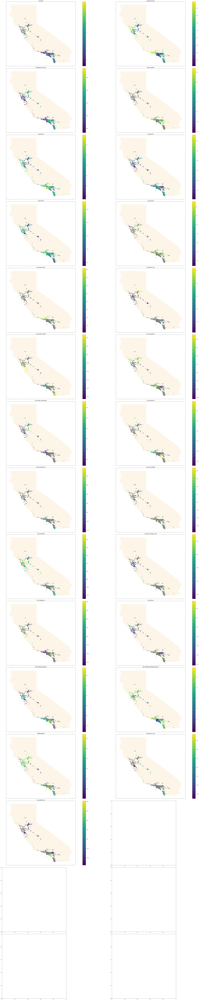

In [ ]:
# plot each of the coefficients

fig, ax = plt.subplots(13, 2, figsize=(50,200), subplot_kw=dict(aspect='equal'))

ax = ax.flatten()

i = 0

for col in gdf_agg.columns:

  if 'est' in col:
  
    # gdf_agg[cols[i] + '_est'] = gwr_results.params[:,i]

    df_grid.plot(ax=ax[i], color='oldlace')

    # column_name = cols[i] + '_est'

    gdf_agg.plot(column=col, missing_kwds={'color': 'oldlace'}, legend=True, ax=ax[i]) 

    gdf_agg[gdf_agg[col[:-3] + 'tval'] == 0].plot(color='grey', ax=ax[i])

    ax[i].set_title(cols[i], fontsize=16)

    ax[i].set_xticklabels([])
    ax[i].set_xticks
    ax[i].set_yticklabels([])
    ax[i].set_yticks

    i += 1

fig.tight_layout()
plt.show()

In [ ]:
# save the summary table

cols = gdf_agg.drop(['ID', 'geom', 'geometry', 'ShannonBird', 'pct_deciduous', 
                     'pct_perfect_flowers', 'CountNativeTrees', 'CountNativeTreeSpecies',
                     'nativeTree', 'nativeSpecies', 'cnt_fleshy_fruit', 'cnt_dehiscent',
                     'cnt_indehiscent', 'pct_indehiscent', 'Population', 'avg_act_evaptrans', 
                     'avg_pot_evaptrans', 'PercentNativeTrees', 'PercentNativeTreeSpecies'], axis=1).columns 

cols = cols.insert(0, 'constant')

df_results = pd.DataFrame(columns=['Variable', 'Mean', 'STD', 'Min', 'Median', 'Max'])

params = gwr_results.params

for i in range(gwr_results.k):
  res = [cols[i], np.mean(params[:, i]), np.std(params[:, i]), np.min(params[:, i]), 
         np.median(params[:, i]), np.max(params[:, i])]

  length = len(df_results)
  df_results.loc[length] = res

df_results.to_csv('GWR_summary.csv')

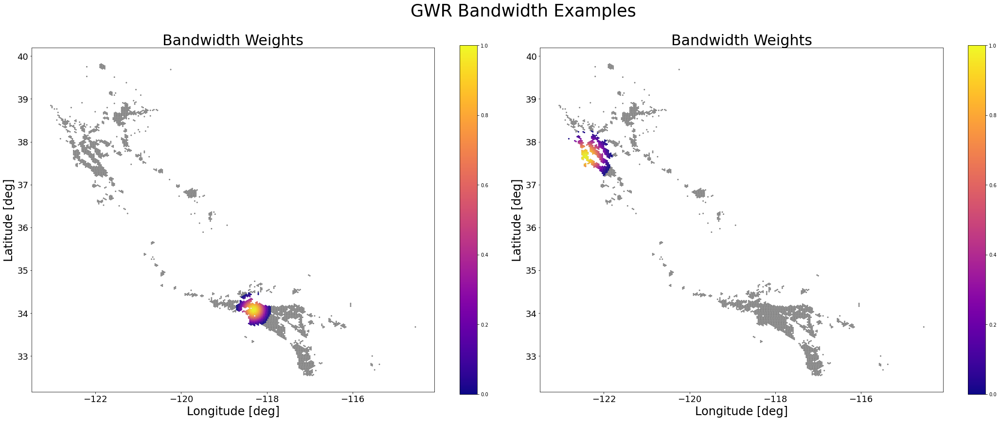

In [27]:
# plot two example bandwidths

fig, ax = plt.subplots(1, 2, figsize=(30, 12), subplot_kw=dict(aspect='equal'))

gdf_agg.plot(color='grey', marker='.', ax=ax[0])

(gdf_agg.assign(localweight=gwr_results.W[10]))\
        .query('localweight > 0')\
        .sort_values('localweight')\
        .plot('localweight', ax=ax[0], cmap='plasma', marker='.', legend=True)

ax[0].set_xlabel('Longitude [deg]', fontdict={'fontsize': 24,
                                           'fontweight': 'medium'}) 
ax[0].set_ylabel('Latitude [deg]', fontdict={'fontsize': 24,
                                           'fontweight': 'medium'}) 
ax[0].set_title('Bandwidth Weights', fontsize=30)
for tick in ax[0].xaxis.get_major_ticks():
    tick.label.set_fontsize(18)
for tick in ax[0].yaxis.get_major_ticks():
    tick.label.set_fontsize(18)

gdf_agg.plot(color='grey', marker='.', ax=ax[1])

(gdf_agg.assign(localweight=gwr_results.W[15]))\
        .query('localweight > 0')\
        .sort_values('localweight')\
        .plot('localweight', ax=ax[1], cmap='plasma', marker='.', legend=True)

ax[1].set_xlabel('Longitude [deg]', fontdict={'fontsize': 24,
                                           'fontweight': 'medium'}) 
ax[1].set_ylabel('Latitude [deg]', fontdict={'fontsize': 24,
                                           'fontweight': 'medium'}) 
ax[1].set_title('Bandwidth Weights', fontsize=30)
for tick in ax[1].xaxis.get_major_ticks():
    tick.label.set_fontsize(18)
for tick in ax[1].yaxis.get_major_ticks():
    tick.label.set_fontsize(18)

st = fig.suptitle('GWR Bandwidth Examples', fontsize=35)
fig.tight_layout()

st.set_y(0.95)
fig.subplots_adjust(top=0.85)

plt.show()

/usr/local/lib/python3.7/dist-packages/geopandas/plotting.py:684: UserWarning: The GeoDataFrame you are attempting to plot is empty. Nothing has been displayed.
  UserWarning,


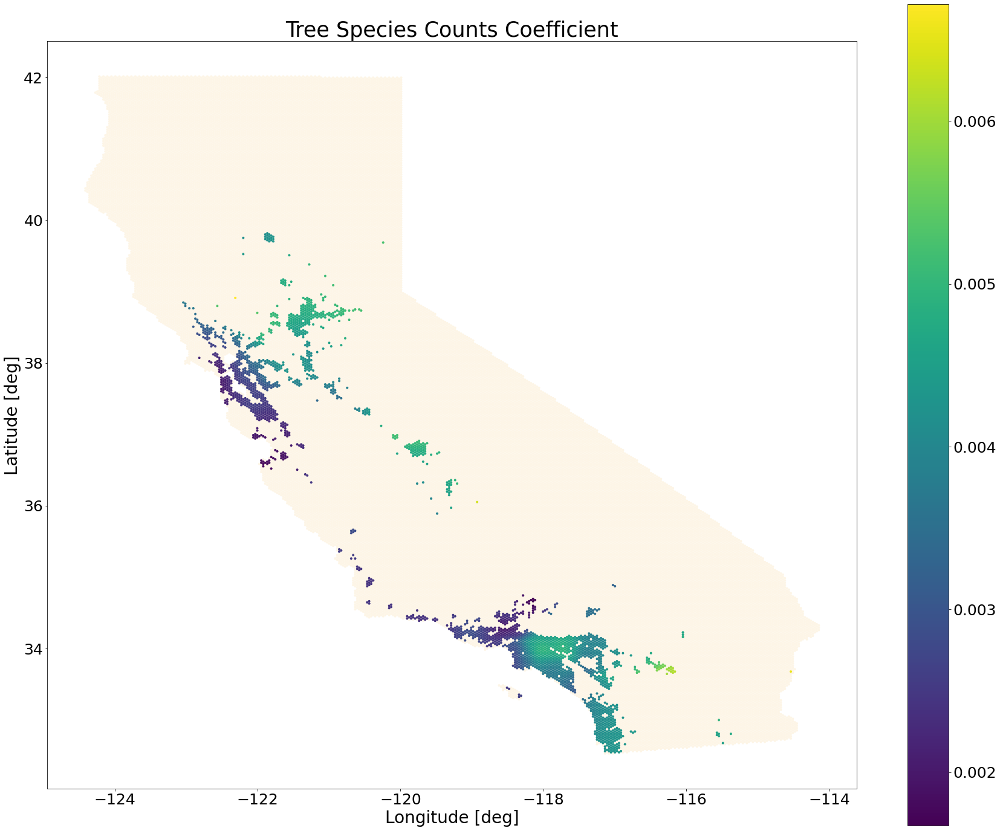

In [ ]:
# plot single variable's coefficients

fig,ax = plt.subplots(figsize=(30,25)) 
df_grid.plot(ax=ax, color='oldlace')

ax2 = gdf_agg.plot(column='TreeSpeciesCounts_est', missing_kwds={'color': 'oldlace'}, 
                   legend=True, ax=ax) 

gdf_agg[gdf_agg['TreeSpeciesCounts_tval'] == 0].plot(color='grey', ax=ax)

ax.set_xlabel('Longitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_ylabel('Latitude [deg]', fontdict={'fontsize': 28,
                                           'fontweight': 'medium'}) 
ax.set_title('Tree Species Counts Coefficient', fontdict={'fontsize': 35,
                                           'fontweight': 'medium'}) 
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
# ax.figure.axes[1].tick_params(labelsize=25)
ax2.figure.axes[1].tick_params(labelsize=25)

fig.show() 